In [66]:
import os
import pandas as pd
import numpy as np
import datetime as dt

from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, accuracy_score
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.layers import LSTM, GRU

import itertools
from itertools import cycle
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns

from numpy import array

In [67]:
file_path = r'C:\Users\rctuh\Desktop\mankind\dataset\TRAIN.csv'

In [68]:
df = pd.read_csv(file_path)

In [69]:
df.head()

,Item code,Category,State,29-01-2017,30-01-2017,31-01-2017,01-02-2017,02-02-2017,03-02-2017,04-02-2017,...,13-02-2022,14-02-2022,15-02-2022,16-02-2022,17-02-2022,18-02-2022,19-02-2022,20-02-2022,21-02-2022,22-02-2022
0,ANTIDIABETIC_001,ANTIDIABETIC,MH,0,0,0,0,0,0,0,...,4,0,0,0,0,1,1,2,0,4
1,ANTIDIABETIC_002,ANTIDIABETIC,MH,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
2,ANTIDIABETIC_003,ANTIDIABETIC,MH,0,0,0,0,0,0,0,...,1,0,0,0,1,0,1,0,1,0
3,ANTIDIABETIC_004,ANTIDIABETIC,MH,0,0,0,0,0,0,0,...,2,1,0,0,0,2,0,5,4,2
4,ANTIDIABETIC_005,ANTIDIABETIC,MH,0,0,0,0,0,0,0,...,5,2,2,2,1,0,0,0,3,0


In [70]:
df.columns

Index(['Item code', 'Category', 'State', '29-01-2017', '30-01-2017',
       '31-01-2017', '01-02-2017', '02-02-2017', '03-02-2017', '04-02-2017',
       ...
       '13-02-2022', '14-02-2022', '15-02-2022', '16-02-2022', '17-02-2022',
       '18-02-2022', '19-02-2022', '20-02-2022', '21-02-2022', '22-02-2022'],
      dtype='object', length=1854)

In [91]:
import pandas as pd

# Assuming 'df' is your dataframe

# Step 1: Reshape the dataframe to a long format
df_long = pd.melt(df, id_vars=['Item code', 'Category', 'State'], var_name='Date', value_name='Sales')

# Convert 'Date' to a datetime type
df_long['Date'] = pd.to_datetime(df_long['Date'], format='%d-%m-%Y')

# Step 2: Aggregate sales by state, item code, category, and date
state_item_sales = df_long.groupby(['State', 'Item code', 'Category', 'Date'])['Sales'].sum().reset_index()

# The 'statewise_sales' dataframe now has columns ['State', 'Date', 'Sales'], with daily sales aggregated at the state level.


In [92]:
state_item_sales

,State,Item code,Category,Date,Sales
0,MH,ANTIBIOTIC_001,ANTIBIOTIC,2017-01-29,3
1,MH,ANTIBIOTIC_001,ANTIBIOTIC,2017-01-30,0
2,MH,ANTIBIOTIC_001,ANTIBIOTIC,2017-01-31,0
3,MH,ANTIBIOTIC_001,ANTIBIOTIC,2017-02-01,1
4,MH,ANTIBIOTIC_001,ANTIBIOTIC,2017-02-02,4
...,...,...,...,...,...
6463687,UP,CARDIOVASCULAR_541,CARDIOVASCULAR,2022-02-18,4
6463688,UP,CARDIOVASCULAR_541,CARDIOVASCULAR,2022-02-19,1
6463689,UP,CARDIOVASCULAR_541,CARDIOVASCULAR,2022-02-20,2
6463690,UP,CARDIOVASCULAR_541,CARDIOVASCULAR,2022-02-21,5


In [93]:
# Get the number of unique values in each column
unique_counts = state_item_sales.nunique()

# Print the number of unique values in each column
print(unique_counts)

State           3
Item code    1164
Category        3
Date         1851
Sales         115
dtype: int64


C:\Users\rctuh\AppData\Local\Temp\ipykernel_20280\3998155927.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



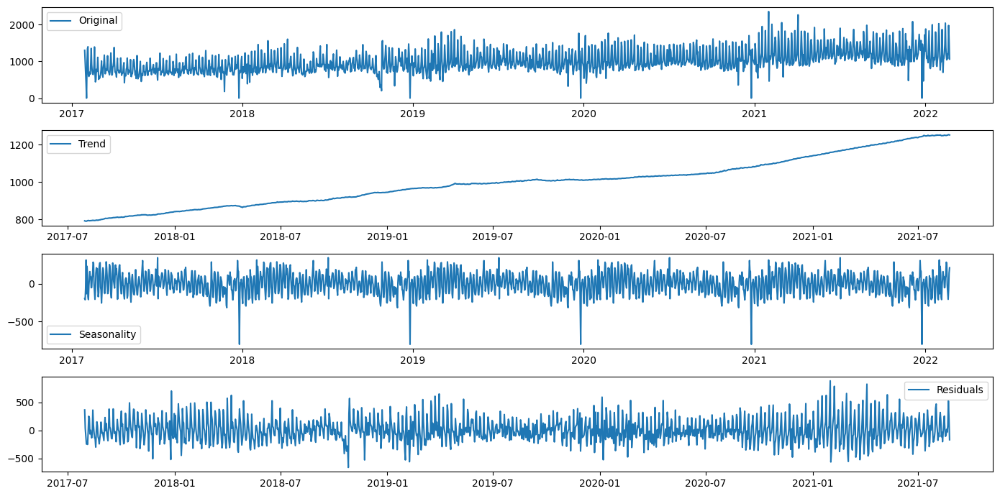

In [73]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

# Example: Select sales data for a specific state
state_sales = statewise_sales[statewise_sales['State'] == 'TN']

# Make sure 'Date' is the index and is in datetime format
state_sales['Date'] = pd.to_datetime(state_sales['Date'])
state_sales.set_index('Date', inplace=True)
state_sales = state_sales['Sales']  # Ensure this is a Series of sales values

# Decompose the time series
decomposition = seasonal_decompose(state_sales, model='additive', period=365)  # Adjust 'period' based on known seasonality

# Plot the decomposed components
plt.figure(figsize=(14, 7))
plt.subplot(411)
plt.plot(state_sales, label='Original')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(decomposition.trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(decomposition.seasonal, label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(decomposition.resid, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()


In [15]:
from statsmodels.tsa.stattools import adfuller

# Function to perform the Augmented Dickey-Fuller test
def adf_test(series):
    result = adfuller(series, autolag='AIC')
    print(f'ADF Statistic: {result[0]}')
    print(f'p-value: {result[1]}')
    print('Critical Values:')
    for key, value in result[4].items():
        print(f'   {key}: {value}')
    
    if result[1] <= 0.05:
        print("The series is stationary")
    else:
        print("The series is not stationary")

# Apply the ADF test on your series
adf_test(state_sales)

# If not stationary, apply differencing
if not adf_test(state_sales):
    state_sales_diff = state_sales.diff().dropna()
    print("Applied first differencing")
    # Check stationarity again
    adf_test(state_sales_diff)


ADF Statistic: -2.3707448270536897
p-value: 0.15016425500007408
Critical Values:
   1%: -3.433936263195097
   5%: -2.8631241351249
   10%: -2.5676133397235263
The series is not stationary
ADF Statistic: -2.3707448270536897
p-value: 0.15016425500007408
Critical Values:
   1%: -3.433936263195097
   5%: -2.8631241351249
   10%: -2.5676133397235263
The series is not stationary
Applied first differencing
ADF Statistic: -11.248199359603776
p-value: 1.738279724050636e-20
Critical Values:
   1%: -3.433940201056092
   5%: -2.8631258735235106
   10%: -2.5676142653629
The series is stationary


Using Prophet

In [16]:
# Reset the index so that Date becomes a regular column
prophet_df = state_sales.reset_index()[['Date', 'Sales']]
prophet_df.rename(columns={'Date': 'ds', 'Sales': 'y'}, inplace=True)

In [17]:
prophet_df

,ds,y
0,2017-01-29,1301
1,2017-01-30,1012
2,2017-01-31,721
3,2017-02-01,408
4,2017-02-02,0
...,...,...
1846,2022-02-18,1071
1847,2022-02-19,1298
1848,2022-02-20,1975
1849,2022-02-21,1555


In [18]:
from prophet import Prophet

# Initialize the Prophet model
model = Prophet()

# Fit the model
model.fit(prophet_df)

23:15:39 - cmdstanpy - INFO - Chain [1] start processing
23:15:39 - cmdstanpy - INFO - Chain [1] done processing


In [19]:
# For forecasting the next 365 days
future = model.make_future_dataframe(periods=365)

# Predict the future
forecast = model.predict(future)

# forecast dataframe contains a lot, but we're interested in 'ds' and 'yhat' primarily


In [20]:
from prophet.plot import plot_plotly, plot_components_plotly

# Plot the forecast
plot_plotly(model, forecast)

# Plot the forecast components
plot_components_plotly(model, forecast)


c:\Python311\Lib\site-packages\plotly\io\_json.py:560: UserWarning:

Discarding nonzero nanoseconds in conversion.



23:20:22 - cmdstanpy - INFO - Chain [1] start processing
23:20:22 - cmdstanpy - INFO - Chain [1] done processing


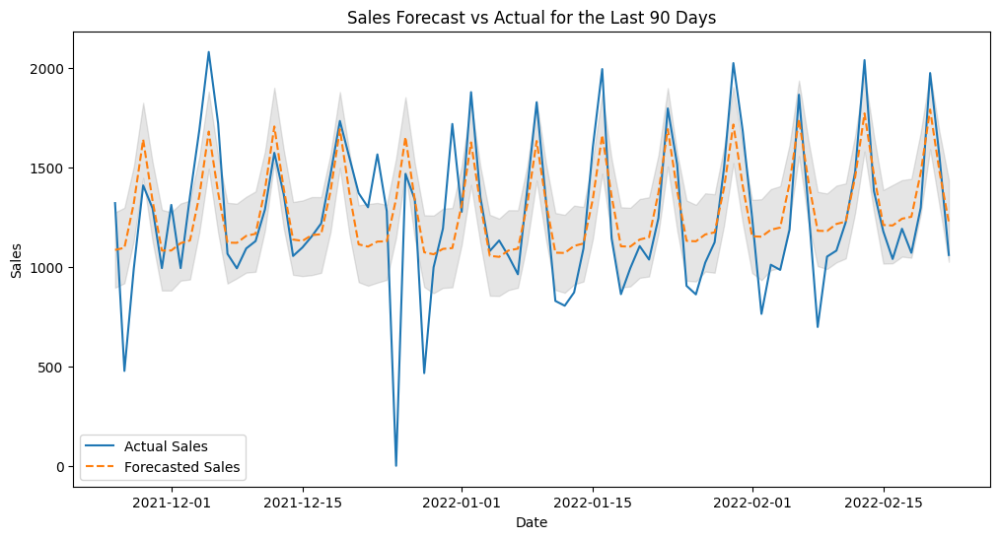

In [21]:
import matplotlib.pyplot as plt
from prophet import Prophet

# Assuming 'prophet_df' is your prepared dataframe

# Initialize and fit the Prophet model
model = Prophet()
model.fit(prophet_df)

# Extend the dataframe to include future dates as well as the past 90 days
future = model.make_future_dataframe(periods=0)  # We don't add future dates here since we're focusing on the past 90 days

# Predict over the entire period (future + past)
forecast = model.predict(future)

# To focus on the last 90 days, we filter both the forecast and historical data
last_90_days_forecast = forecast.set_index('ds').last('90D')  # Last 90 days of forecast
last_90_days_actual = prophet_df.set_index('ds').last('90D')  # Last 90 days of actual data

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(last_90_days_actual.index, last_90_days_actual['y'], label='Actual Sales')
plt.plot(last_90_days_forecast.index, last_90_days_forecast['yhat'], label='Forecasted Sales', linestyle='--')
plt.fill_between(last_90_days_forecast.index, last_90_days_forecast['yhat_lower'], last_90_days_forecast['yhat_upper'], color='gray', alpha=0.2)
plt.title('Sales Forecast vs Actual for the Last 90 Days')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend()
plt.show()


Validation and Accuracy Metrics

In [22]:
from prophet.diagnostics import cross_validation

# Perform cross-validation
df_cv = cross_validation(model, initial='730 days', period='180 days', horizon = '365 days')

# You can then compute performance metrics such as MAE or RMSE on df_cv


  0%|          | 0/5 [00:00<?, ?it/s]

23:23:29 - cmdstanpy - INFO - Chain [1] start processing
23:23:29 - cmdstanpy - INFO - Chain [1] done processing
23:23:29 - cmdstanpy - INFO - Chain [1] start processing
23:23:29 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing


In [23]:
from prophet.diagnostics import performance_metrics

df_p = performance_metrics(df_cv)
print(df_p.head())


  horizon           mse        rmse         mae     mdape     smape  coverage
0 37 days  24237.758445  155.684805  120.130491  0.093664  0.113385  0.778022
1 38 days  23902.502294  154.604341  119.070372  0.097086  0.111643  0.774725
2 39 days  23465.200083  153.183550  118.526810  0.092626  0.111110  0.775824
3 40 days  24891.646331  157.770867  121.456643  0.100717  0.112721  0.767033
4 41 days  27615.694329  166.179705  124.987249  0.100717  0.114343  0.761538


Plotting the sales for the next 90 days

23:25:11 - cmdstanpy - INFO - Chain [1] start processing
23:25:11 - cmdstanpy - INFO - Chain [1] done processing


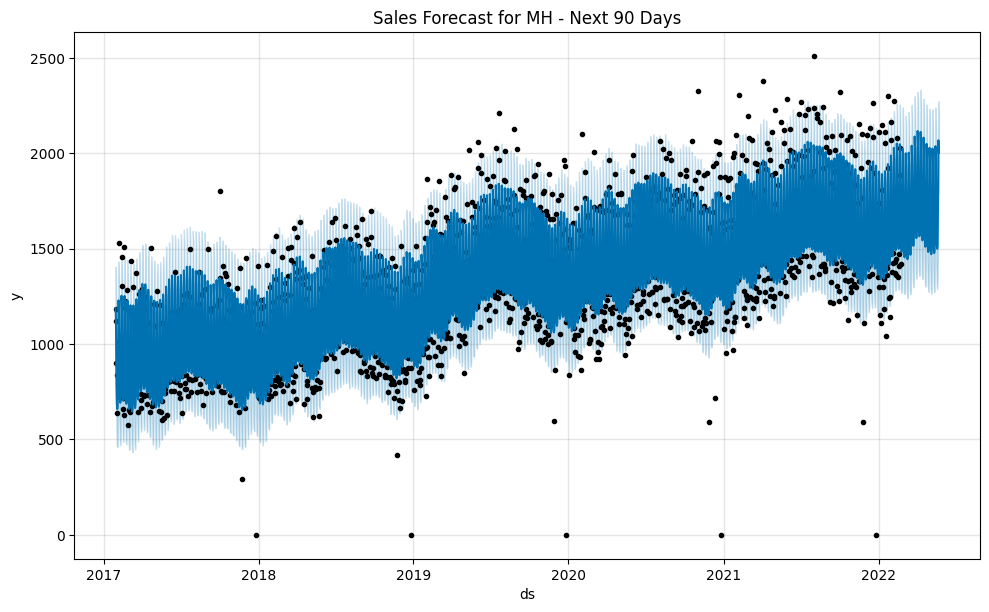

23:25:12 - cmdstanpy - INFO - Chain [1] start processing
23:25:12 - cmdstanpy - INFO - Chain [1] done processing


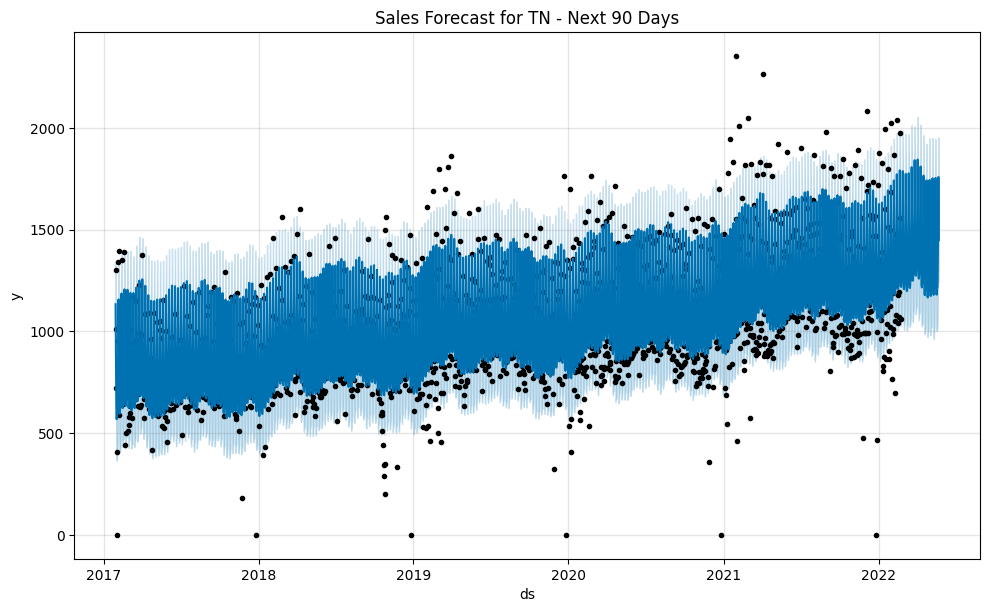

23:25:13 - cmdstanpy - INFO - Chain [1] start processing
23:25:13 - cmdstanpy - INFO - Chain [1] done processing


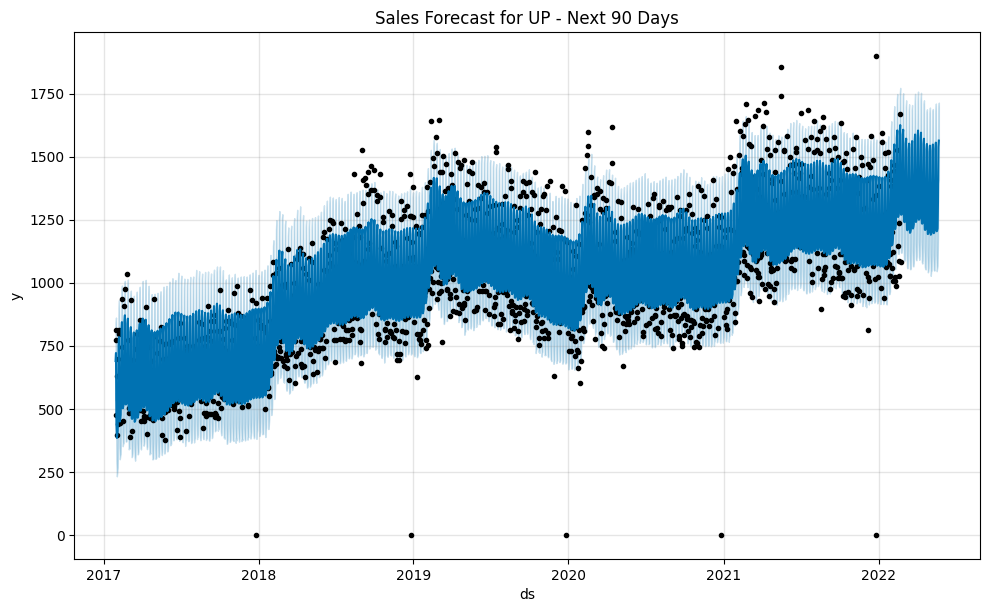

In [25]:
from prophet import Prophet
import matplotlib.pyplot as plt

# Assuming 'statewise_sales' is your DataFrame containing all states' sales data
states = statewise_sales['State'].unique()  # Get unique states

for state in states:
    # Prepare the data for Prophet
    state_data = statewise_sales[statewise_sales['State'] == state]
    df = state_data.reset_index()[['Date', 'Sales']]
    df.rename(columns={'Date': 'ds', 'Sales': 'y'}, inplace=True)
    
    # Initialize and fit the Prophet model
    model = Prophet()
    model.fit(df)
    
    # Forecast the next 90 days
    future = model.make_future_dataframe(periods=90)
    forecast = model.predict(future)
    
    # Plotting the forecast
    fig = model.plot(forecast)
    plt.title(f'Sales Forecast for {state} - Next 90 Days')
    plt.show()


Since WMAPE real accuracy would require the real values of the sales , we go ahead checking the model with the previous data

In [26]:
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Split the data
cutoff_date = prophet_df['ds'].max() - pd.Timedelta(days=90)
train_df = prophet_df[prophet_df['ds'] <= cutoff_date]
test_df = prophet_df[prophet_df['ds'] > cutoff_date]

# Initialize and fit the Prophet model on the training dataset
model = Prophet()
model.fit(train_df)

# Make predictions for the next 90 days
future = model.make_future_dataframe(periods=90, include_history=False)
forecast = model.predict(future)

# Align forecasted data with actual test data for comparison
forecasted = forecast.set_index('ds')['yhat'].reindex(test_df['ds'])
actuals = test_df.set_index('ds')['y']

# Calculate MAE
mae = mean_absolute_error(actuals, forecasted)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(actuals, forecasted))

# Calculate WMAPE
wmape = np.sum(np.abs(forecasted - actuals)) / np.sum(actuals)

print(f"MAE: {mae}")
print(f"RMSE: {rmse}")
print(f"WMAPE: {wmape * 100}%")


23:28:30 - cmdstanpy - INFO - Chain [1] start processing
23:28:30 - cmdstanpy - INFO - Chain [1] done processing


MAE: 192.6110033740097
RMSE: 267.06306110082033
WMAPE: 15.323071071918035%


Transitioning to ARIMA model

In [27]:
import pandas as pd
import numpy as np
from statsmodels.tsa.stattools import adfuller, acf, pacf
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt


In [32]:
statewise_sales

,State,Date,Sales
0,MH,2017-01-29,1186
1,MH,2017-01-30,1123
2,MH,2017-01-31,902
3,MH,2017-02-01,836
4,MH,2017-02-02,640
...,...,...,...
5548,UP,2022-02-18,1087
5549,UP,2022-02-19,1237
5550,UP,2022-02-20,1452
5551,UP,2022-02-21,1668


In [34]:
result = adfuller(statewise_sales['Sales'])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])


ADF Statistic: -2.697289
p-value: 0.074509


C:\Users\rctuh\AppData\Local\Temp\ipykernel_20280\175547857.py:4: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



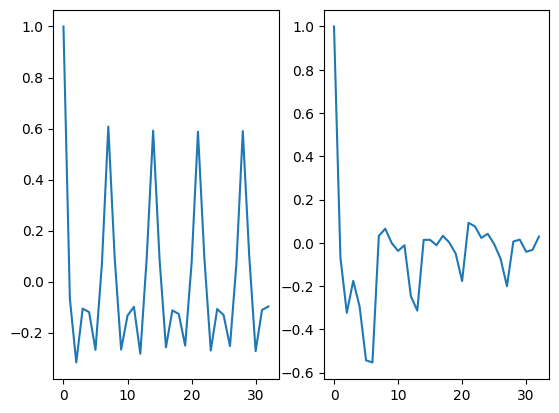

In [35]:
fig, ax = plt.subplots(2,1)
acf_values = acf(state_sales_diff)
pacf_values = pacf(state_sales_diff)
plt.subplot(121)
plt.plot(acf_values)
plt.subplot(122)
plt.plot(pacf_values)


ACF Plot (usually the first plot): It appears to show significant autocorrelations at multiple lags, which decline but do not cut off abruptly. This indicates that the data could be well-represented by a Moving Average (MA) process.

PACF Plot (usually the second plot): The PACF shows a sharp cut-off after the first lag, suggesting that an Autoregressive (AR) process of order 1 might be a good fit.

In [39]:
model = ARIMA(statewise_sales['Sales'], order=(1,0,1))
model_fit = model.fit()

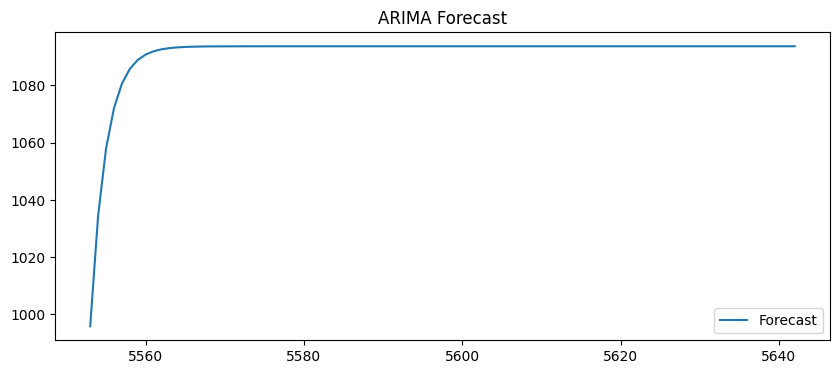

In [40]:
# Forecast the next 90 days
forecast = model_fit.forecast(steps=90)

# Plotting the forecast
plt.figure(figsize=(10, 4))
plt.plot(forecast, label='Forecast')
plt.legend()
plt.title('ARIMA Forecast')
plt.show()

Processing MH...


c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.



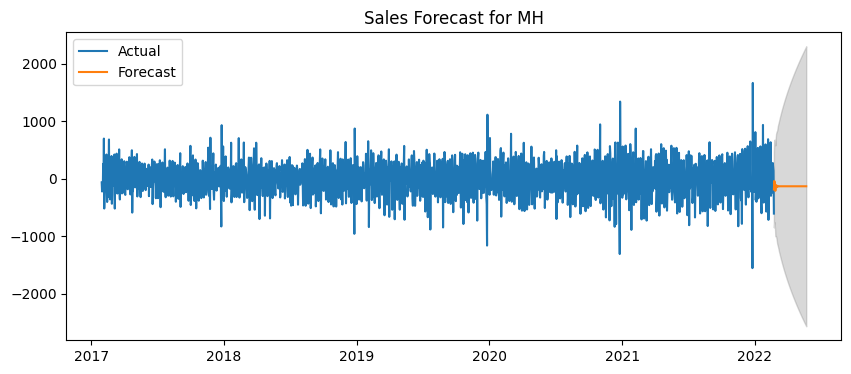

Processing TN...


c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.



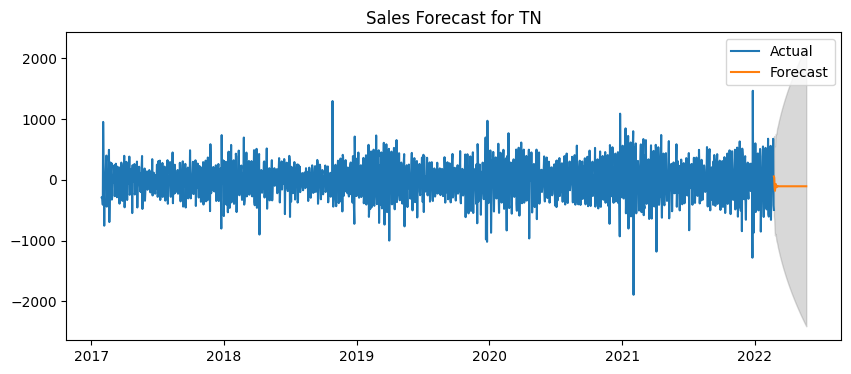

Processing UP...


c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.



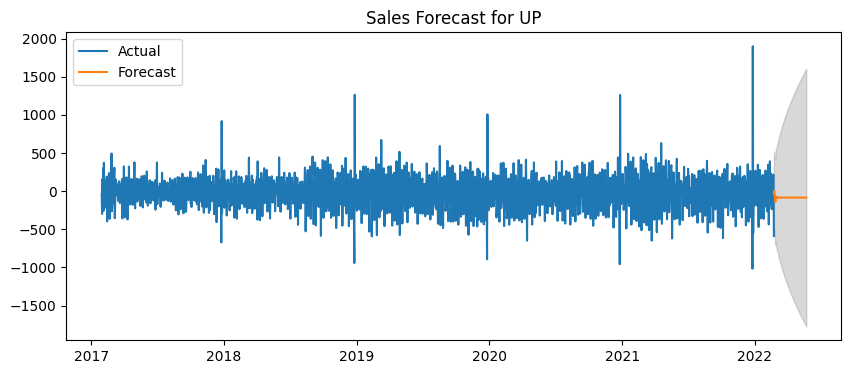

In [50]:

states = statewise_sales['State'].unique()

for state in states:
    print(f"Processing {state}...")
    # Select the data for the state
    state_data = statewise_sales[statewise_sales['State'] == state].copy()
    state_data['Date'] = pd.to_datetime(state_data['Date'])
    state_data.set_index('Date', inplace=True)
    state_sales = state_data['Sales']

    # Test stationarity
    p_value = test_stationarity(state_sales)
    if p_value > 0.05:
        # Data is not stationary, perform differencing
        d = 1
        state_sales = state_sales.diff().dropna()
    else:
        d = 0

    # Find the optimal ARIMA parameters for the state's data (this is a complex step that might require separate analysis)
    # For the sake of example, let's assume p=1 and q=1
    p = 1
    q = 1
    
    # Fit the ARIMA model (using the differencing level found earlier)
    model = ARIMA(state_sales, order=(4,1,0))
    model_fit = model.fit()
    
    # Forecast the next 90 days
    forecast = model_fit.get_forecast(steps=90)
    forecast_index = pd.date_range(state_sales.index[-1], periods=90)
    forecast_values = forecast.predicted_mean
    forecast_ci = forecast.conf_int()

    # Plot the actual data and forecasts
    plt.figure(figsize=(10, 4))
    plt.plot(state_sales, label='Actual')
    plt.plot(forecast_index, forecast_values, label='Forecast')
    plt.fill_between(forecast_index, forecast_ci.iloc[:, 0], forecast_ci.iloc[:, 1], color='gray', alpha=0.3)
    plt.title(f'Sales Forecast for {state}')
    plt.legend()
    plt.show()

We are getting unsatisfactory results with normal ARIMA model , we use use AUTOARIMA to automatically get the most optimum values for p,d,f and better forecast values 

Plotting the model on the basis of the previous 90 days using AUTOARIMA

In [98]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from pmdarima import auto_arima

# Assuming 'state_item_sales' is your dataframe with aggregated sales data

# Step 1: Filter data for the previous 90 days
end_date = state_item_sales['Date'].max()  # Get the latest date in the data
start_date = end_date - pd.Timedelta(days=90)  # Calculate the start date for the previous 90 days
previous_90_days_data = state_item_sales[state_item_sales['Date'].between(start_date, end_date)]

# Step 2: Run auto_arima and plot forecasts for each state
fig = go.Figure()

for state in state_item_sales['State'].unique():
    # Filter data for the current state
    state_data = previous_90_days_data[previous_90_days_data['State'] == state]
    
    # Run auto_arima to forecast the previous 90 days values for the current state
    #model = auto_arima(state_data['Sales'], seasonal=True, m=7)  # Assuming weekly seasonality (m=7)
    model = auto_arima(state_data['Sales'], start_p=1, start_q=1,
                       test='adf',       # Use the Augmented Dickey-Fuller test to find optimal 'd'
                       max_p=5, max_q=5, # Maximum p and q
                       m=12,              # Frequency of the series (if not seasonal set m=1)
                       d=None,           # Let model determine 'd'
                       seasonal=False,   # No Seasonality
                       start_P=0, 
                       D=0, 
                       trace=True,
                       error_action='ignore',  
                       suppress_warnings=True, 
                       stepwise=True)

    print(model.summary())
    forecast = model.predict(n_periods=90)
    
    # Plot the forecast for the current state
    trace = go.Scatter(x=state_data['Date'], y=state_data['Sales'], mode='lines', name=f'Real Values - {state}')
    fig.add_trace(trace)
    
    trace_forecast = go.Scatter(x=state_data['Date'], y=forecast, mode='lines', name=f'Forecasted Values - {state}')
    fig.add_trace(trace_forecast)

fig.update_layout(title='Real vs Forecasted Sales for Previous 90 Days (Statewise)',
                  xaxis=dict(title='Date'),
                  yaxis=dict(title='Sales'))
fig.show()


c:\Python311\Lib\site-packages\pmdarima\arima\_validation.py:62: UserWarning:

m (12) set for non-seasonal fit. Setting to 0



Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=472936.714, Time=6.21 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=543610.588, Time=0.58 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=501200.202, Time=0.77 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=518751.413, Time=2.60 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=472601.351, Time=8.03 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=490696.798, Time=0.98 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=472578.539, Time=15.56 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=485697.645, Time=2.68 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=472393.710, Time=22.52 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=481893.556, Time=3.42 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=472276.434, Time=26.42 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=478639.719, Time=4.11 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=472303.335, Time=51.65 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=472581.178, Time=19.15 sec


c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

c:\Python311\Lib\site-packages\pmdarima\arima\_validation.py:62: UserWarning:

m (12) set for non-seasonal fit. Setting to 0



Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=424802.302, Time=6.25 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=494851.722, Time=0.59 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=450267.845, Time=0.76 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=468502.631, Time=2.30 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=424044.483, Time=9.72 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=440538.416, Time=1.97 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=424044.403, Time=18.07 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=435530.703, Time=2.59 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=424017.967, Time=23.61 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=432583.050, Time=3.25 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=423928.055, Time=28.65 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=430525.265, Time=3.97 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=423970.698, Time=47.95 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=424038.478, Time=21.03 sec


c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

c:\Python311\Lib\site-packages\pmdarima\arima\_validation.py:62: UserWarning:

m (12) set for non-seasonal fit. Setting to 0



Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=428466.994, Time=5.94 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=499199.551, Time=0.59 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=456830.639, Time=0.77 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=475061.586, Time=2.30 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=428289.684, Time=8.90 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=444206.793, Time=0.98 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=428252.240, Time=17.04 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=439468.970, Time=1.25 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=428183.934, Time=20.44 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=436672.019, Time=3.26 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=427973.134, Time=27.81 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=433623.830, Time=3.98 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=427970.073, Time=51.43 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=428254.870, Time=18.11 sec


c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

c:\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



Processing MH...
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=26155.489, Time=0.11 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=31917.486, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=26156.520, Time=0.03 sec


c:\Python311\Lib\site-packages\pmdarima\arima\_validation.py:62: UserWarning:

m (12) set for non-seasonal fit. Setting to 0



 ARIMA(0,0,1)(0,0,0)[0]             : AIC=29804.039, Time=0.18 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=26145.069, Time=0.32 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=26156.803, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=25281.724, Time=1.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=26061.798, Time=0.07 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=25112.615, Time=1.05 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.10 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=24924.956, Time=1.17 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.16 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=25074.614, Time=1.89 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=1.91 sec
 ARIMA(5,0,1)(0,0,0)[0] intercept   : AIC=25301.036, Time=2.27 sec

Best model:  ARIMA(5,0,1)(0,0,0)[0]          
Total fit time: 10.530 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:

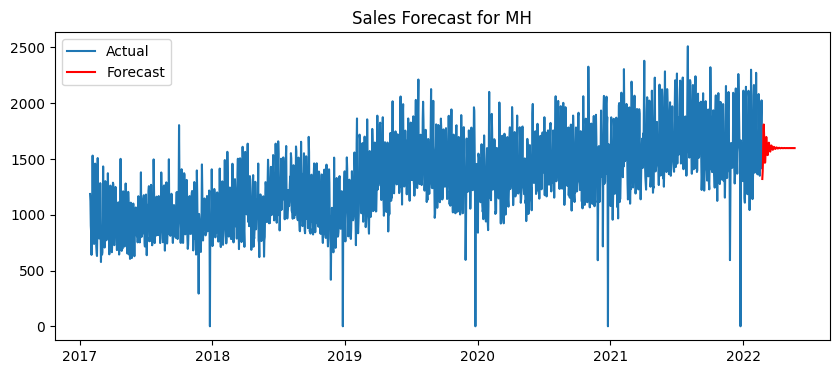

Processing TN...
Performing stepwise search to minimize aic


c:\Python311\Lib\site-packages\pmdarima\arima\_validation.py:62: UserWarning:

m (12) set for non-seasonal fit. Setting to 0



 ARIMA(1,0,1)(0,0,0)[0]             : AIC=26151.287, Time=0.21 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=30996.688, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=26165.582, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=28981.918, Time=0.13 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=26141.049, Time=0.33 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=26162.919, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=25246.328, Time=0.82 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=25975.168, Time=0.07 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=25197.390, Time=1.13 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=25923.274, Time=0.12 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=24986.762, Time=1.47 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.17 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=24727.764, Time=1.63 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=2.01 sec
 ARIMA(5,0,3)(0,0,0)[0]             : AIC=inf, Time=2.14 sec
 ARIMA(4,0,3)

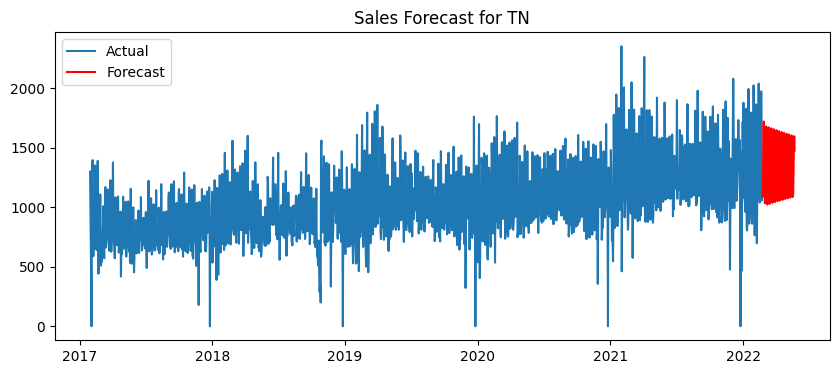

Processing UP...
Performing stepwise search to minimize aic


c:\Python311\Lib\site-packages\pmdarima\arima\_validation.py:62: UserWarning:

m (12) set for non-seasonal fit. Setting to 0



 ARIMA(1,0,1)(0,0,0)[0]             : AIC=24671.808, Time=0.26 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=30911.364, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=25029.204, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=28857.767, Time=0.13 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=24411.753, Time=0.60 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=25010.739, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=24246.158, Time=0.59 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=24927.179, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=24120.783, Time=0.80 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.09 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=23943.603, Time=0.97 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.16 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=24120.425, Time=1.62 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=2.45 sec
 ARIMA(5,0,1)(0,0,0)[0] intercept   : AIC=24276.814, Time=2.18 sec

Best model: 

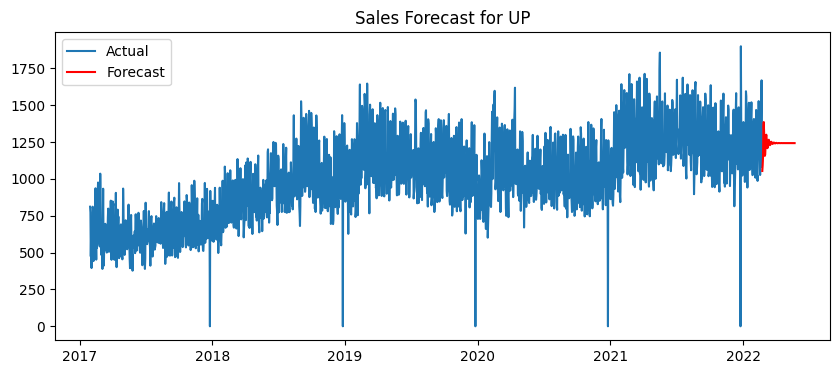

In [80]:
import pandas as pd
from pmdarima import auto_arima
import matplotlib.pyplot as plt

# Assuming statewise_sales is your DataFrame
states = statewise_sales['State'].unique()

for state in states:
    print(f"Processing {state}...")
    # Select the data for the state
    state_data = statewise_sales[statewise_sales['State'] == state].copy()
    state_data['Date'] = pd.to_datetime(state_data['Date'])
    state_data.set_index('Date', inplace=True)
    state_sales = state_data['Sales']
    
    # No need to manually test stationarity; auto_arima can handle differencing
    # Auto ARIMA to find the best model
    model = auto_arima(state_sales, start_p=1, start_q=1,
                       test='adf',       # Use the Augmented Dickey-Fuller test to find optimal 'd'
                       max_p=5, max_q=5, # Maximum p and q
                       m=12,              # Frequency of the series (if not seasonal set m=1)
                       d=None,           # Let model determine 'd'
                       seasonal=False,   # No Seasonality
                       start_P=0, 
                       D=0, 
                       trace=True,
                       error_action='ignore',  
                       suppress_warnings=True, 
                       stepwise=True)

    print(model.summary())

    # Forecast the next 90 days
    forecast = model.predict(n_periods=90)
    forecast_index = pd.date_range(state_sales.index[-1] + pd.Timedelta(days=1), periods=90)
    
    # Plot the actual data and forecasts
    plt.figure(figsize=(10, 4))
    plt.plot(state_sales, label='Actual')
    plt.plot(forecast_index, forecast, label='Forecast', color='red')
    plt.title(f'Sales Forecast for {state}')
    plt.legend()
    plt.show()


In [81]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Example data
actual_sales_index = state_sales.index[-90:]  # Last 90 days of actual sales
forecast_index = pd.date_range(state_sales.index[-1] + pd.Timedelta(days=1), periods=91)  # Forecast index

# Actual and forecasted sales data
actual_sales = state_sales[-90:]
forecast_sales = forecast  # Assuming 'forecast' contains your forecasted sales for the next 90 days

# Create subplots
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add actual sales trace
fig.add_trace(
    go.Scatter(x=actual_sales_index, y=actual_sales, name="Actual Sales"),
    secondary_y=False,
)

# Add forecast sales trace
fig.add_trace(
    go.Scatter(x=forecast_index, y=forecast_sales, name="Forecasted Sales", mode='lines+markers'),
    secondary_y=True,
)

# Add figure title
fig.update_layout(title_text="Actual vs Forecasted Sales")

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="Actual Sales", secondary_y=False)
fig.update_yaxes(title_text="Forecasted Sales", secondary_y=True)

# Show plot
fig.show()


In [79]:
# Print the raw WMAPE value
raw_wmape = metrics['WMAPE']
print(f"Raw WMAPE: {raw_wmape}")

# Also, check the total sum of actual sales to see if it's significantly larger
total_actual_sales = actual_sales.sum()
print(f"Total Actual Sales: {total_actual_sales}")


Raw WMAPE: 0.0
Total Actual Sales: 108388


In [77]:
actual_sales

Date
2021-11-25    1293
2021-11-26     951
2021-11-27    1079
2021-11-28    1109
2021-11-29    1296
              ... 
2022-02-18    1087
2022-02-19    1237
2022-02-20    1452
2022-02-21    1668
2022-02-22    1081
Name: Sales, Length: 90, dtype: int64

In [78]:
forecast_values

2022-02-23    -31.399875
2022-02-24      5.488326
2022-02-25    -46.381361
2022-02-26    -98.022595
2022-02-27   -136.456772
                 ...    
2022-05-19    -83.924951
2022-05-20    -83.924951
2022-05-21    -83.924951
2022-05-22    -83.924951
2022-05-23    -83.924951
Freq: D, Name: predicted_mean, Length: 90, dtype: float64